# Testing the same concept on SynCAN dataset

This notebook validates our correlation approach on the SynCAN from here: data https://github.com/etas/SynCAN

In [2]:
from scripts.config import input_data
import pandas as pd
# import display
from IPython.display import display

# Already concatenated all the train files into one file
if False:
    # Load the data
    df_train = pd.read_csv(f"{input_data}/SynCAN-master/train_1.csv")

    # read other train files and concatenate to df_train
    files  = ['train_2.csv', 'train_3.csv', 'train_4.csv']
    for file in files:
        temp =  pd.read_csv(f"{input_data}/SynCAN-master/{file}", names=["Label","Time","ID","Signal1","Signal2","Signal3","Signal4"])
        print(temp.shape)
        display(temp.head())

        df_train = pd.concat([
            df_train, 
            temp
            ])
    
    for id in df_train["ID"].unique():
        filtered = df_train.query(f'ID=="{id}"')
        display(filtered.head())
        print(filtered.shape)
        break

    import numpy as np

    # interpolate the data

    final_df = pd.DataFrame()
    t = df_train.index 
    for id in df_train["ID"].unique():
            # Filter on message ID
            filtered = df_train.query(f'ID=="{id}"')

            # If there are less than 3 messages, we can't interpolate
            if len(filtered) < 3:
                    raise Exception("Not enough message to interpolate (probably)")
            

            
            # iterate over the 4 signals, and interpolate them, then add them to the final df
            for i in range(1,5):
                # get all not nan rows
                not_nan = filtered[filtered[f"Signal{i}"].notna()]
                
                # if no not nan rows, break
                if len(not_nan) == 0:
                    break

                final_df[f"{id}_{i}"] = np.interp(t, not_nan.index, not_nan[f"Signal{i}"])


    # save the final df
    final_df.to_csv(f"{work_dir}/SynCAN-master/interpolated_train_data.csv", index=False)

In [3]:
file = f"{input_data}/SynCAN-master/train_input/SynCAN_interpolated_train_data.csv"

In [ ]:
df_train = pd.read_csv(file)

In [4]:
df_train.shape

(29669726, 20)

In [5]:
# check if any column contains only NaN values
# print "no only NaNs" if no column contains only NaN values
if df_train.isnull().all().any():
    print("there is at least one only NaN column!!")
else:
    print("Each column contains at least one non-NaN value")

Each column contains at least one non-NaN value


<Axes: >

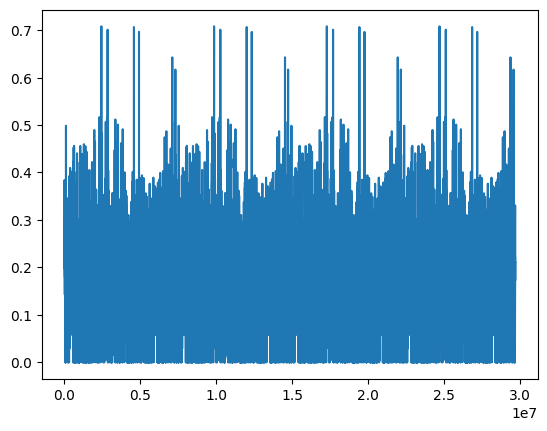

In [8]:
df_train["id8_1"].plot()

# Correlation analysis

In [9]:
data = df_train

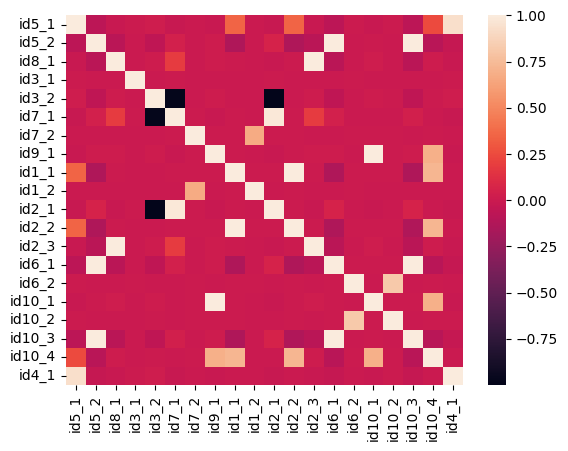

In [10]:
import seaborn as sb
import matplotlib.pyplot as plt


dataplot = sb.heatmap(data.corr())

plt.show()

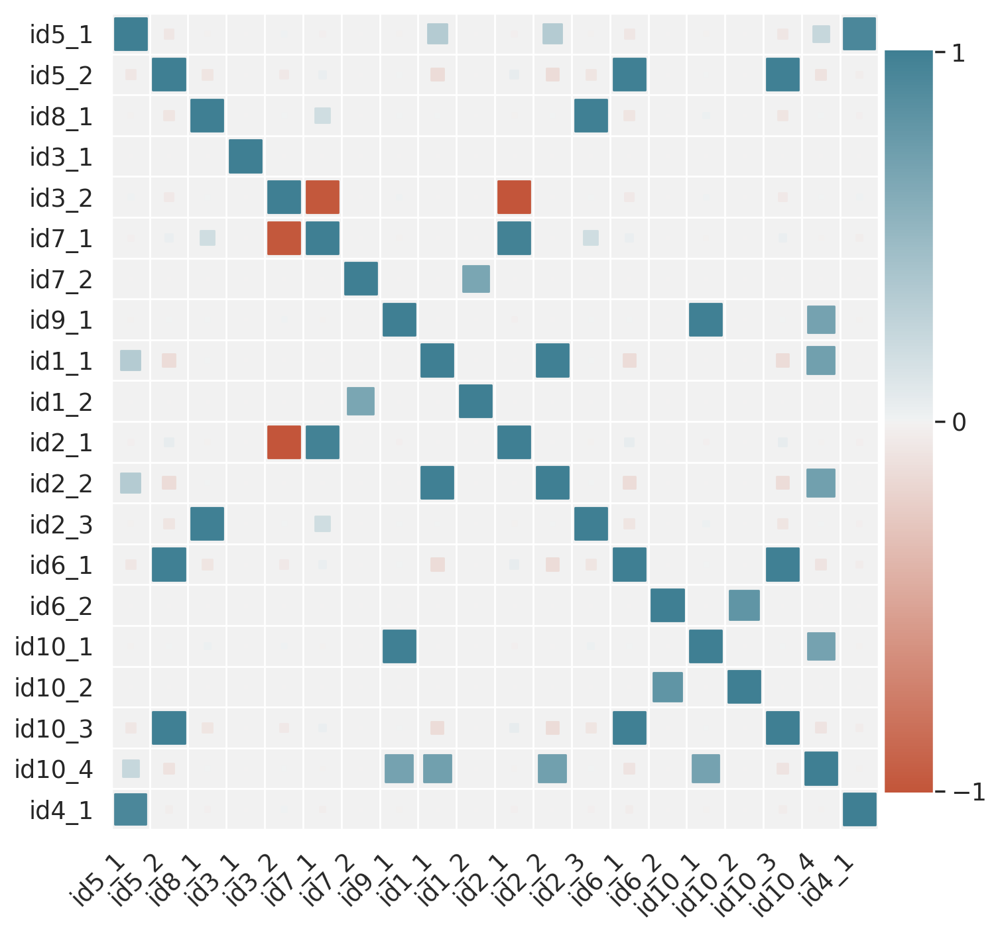

In [12]:
import pandas as pd
from matplotlib import pyplot as plt
from pylab import rcParams
rcParams['figure.figsize'] = 7,7 
import seaborn as sns
import numpy as np
sns.set(color_codes=True, font_scale=1.2)

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%load_ext autoreload
%autoreload 2

# Import the two methods from heatmap library
from heatmap import heatmap, corrplot

plt.figure(figsize=(8, 8))
corrplot(data.corr(), size_scale=300)

# Clustering analysis

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_mds.py:298: FutureWarning: The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.
  warnings.warn(


############################ Correlation type:  pearson
----------------------------- DBSCAN clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster 1: id7_1, id2_1, id3_2
Cluster 2: id9_1, id10_1
Cluster 3: id1_1, id2_2
Cluster -1: id10_4, id7_2, id1_2, id3_1
Cluster 4: id5_1, id4_1
Cluster 5: id8_1, id2_3
Cluster 6: id6_2, id10_2


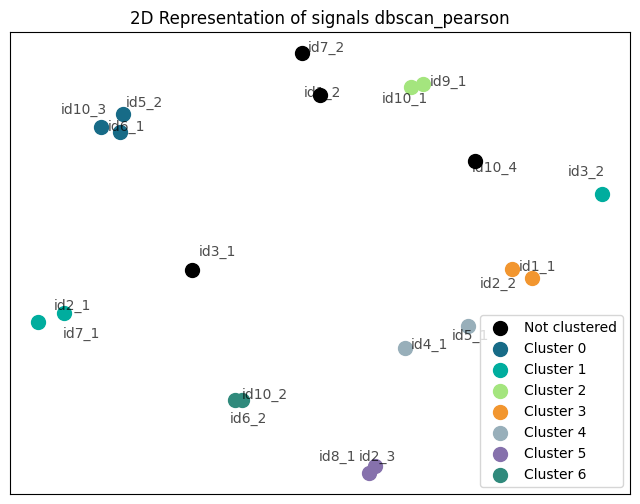

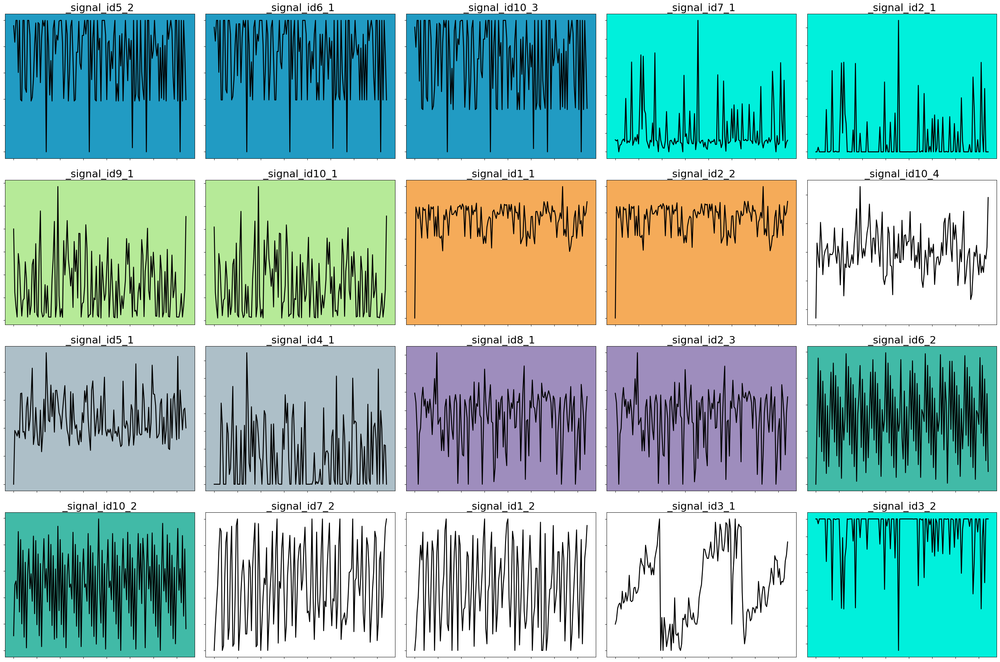

----------------------------- Affinity propagation clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster 7: id7_1, id2_1, id3_2
Cluster 1: id9_1, id10_1, id10_4, id3_1
Cluster 2: id1_1, id2_2
Cluster 3: id5_1, id4_1
Cluster 4: id8_1, id2_3
Cluster 5: id6_2, id10_2
Cluster 6: id7_2, id1_2


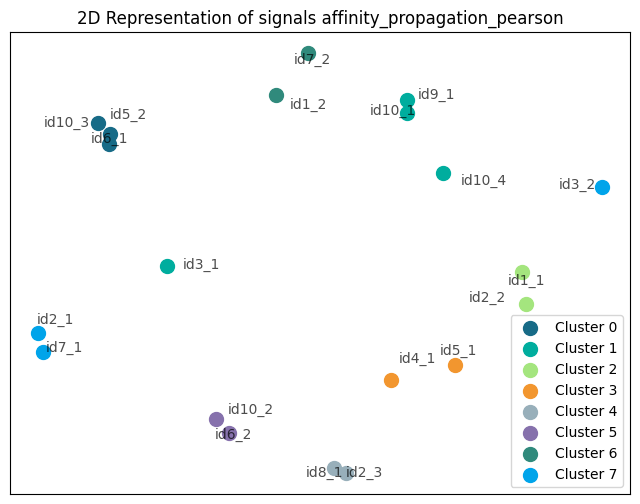

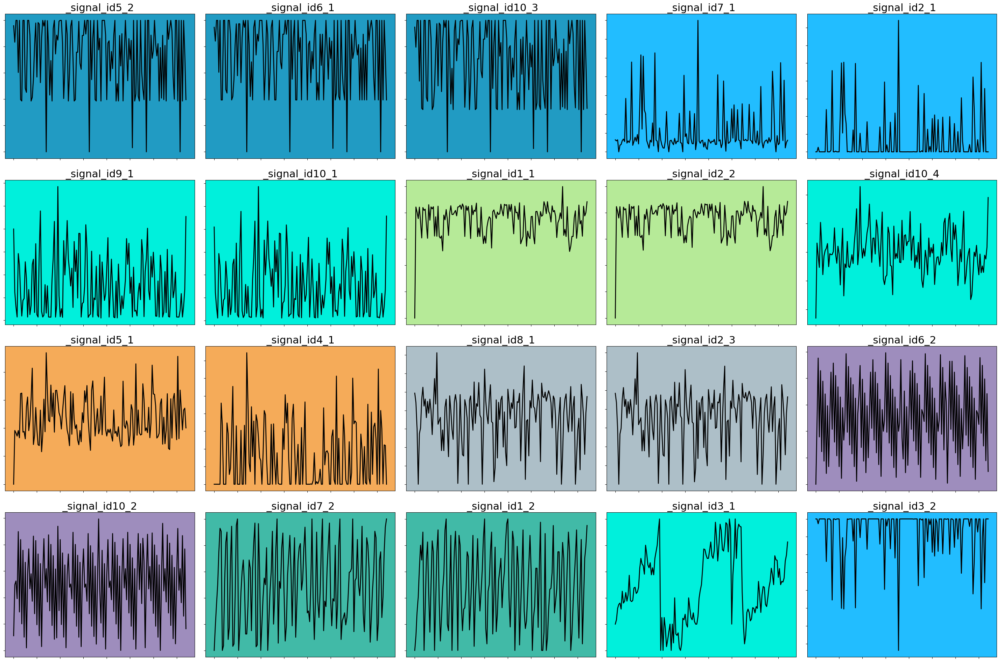

----------------------------- Hierarchical clustering with pairwise distances --------------------------
Cluster 10: id5_2, id6_1, id10_3
Cluster 6: id7_1, id2_1, id3_2
Cluster 3: id9_1, id10_1
Cluster 9: id1_1, id2_2
Cluster 4: id10_4
Cluster 0: id5_1, id4_1
Cluster 1: id8_1, id2_3
Cluster 2: id6_2, id10_2
Cluster 7: id7_2
Cluster 8: id1_2
Cluster 5: id3_1


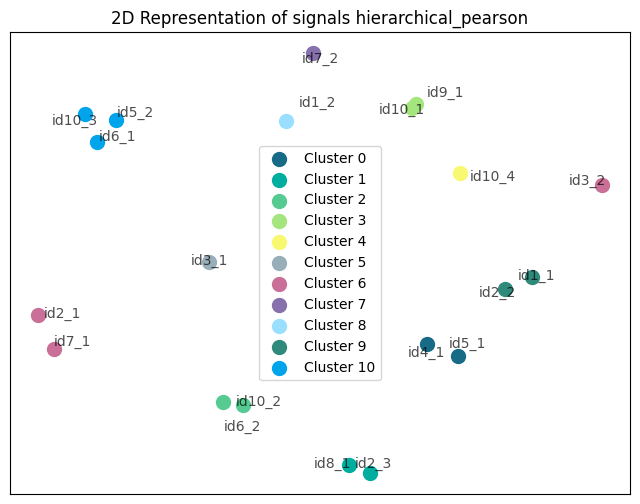

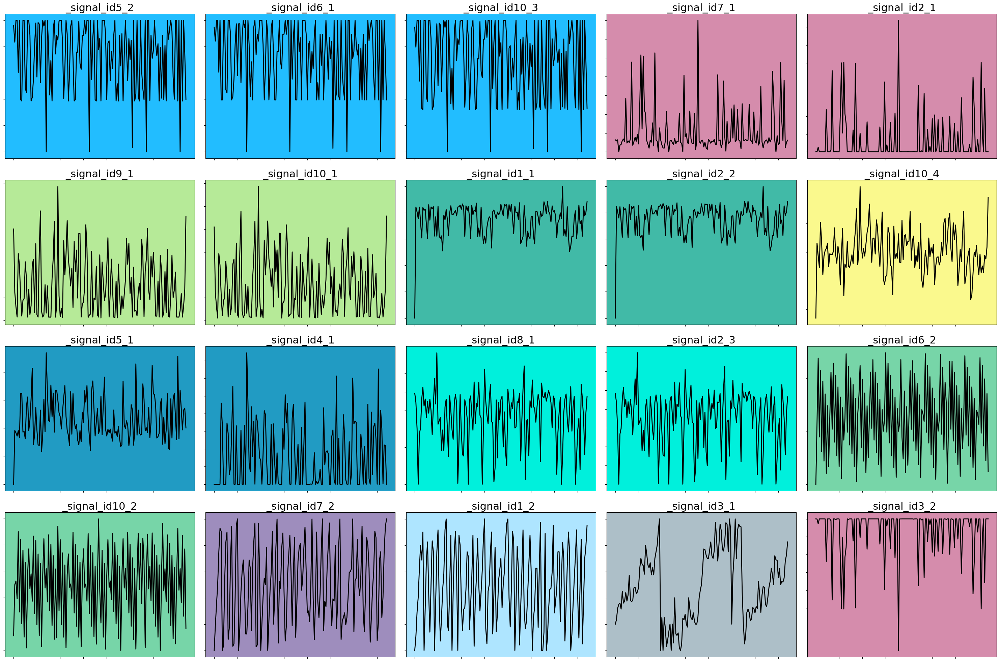

----------------------------- MeanShift clustering -----------------------------
Cluster 1: id5_2, id6_1, id10_3
Cluster 0: id7_1, id2_1, id3_2
Cluster 2: id9_1, id10_1
Cluster 6: id1_1, id2_2
Cluster 8: id10_4
Cluster 10: id5_1
Cluster 9: id4_1
Cluster 5: id8_1, id2_3
Cluster 4: id6_2, id10_2
Cluster 3: id7_2, id1_2
Cluster 7: id3_1


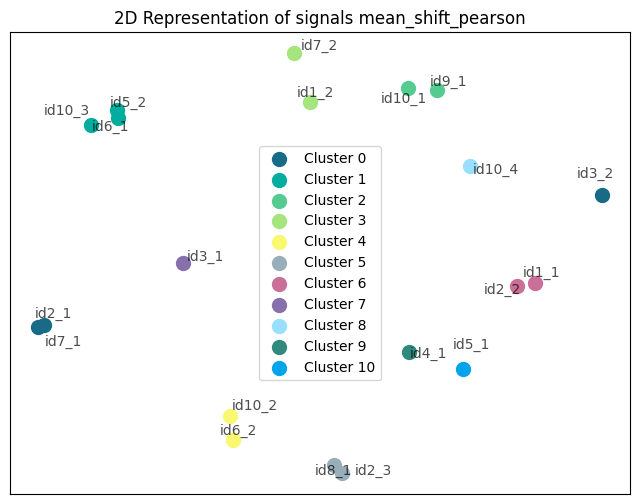

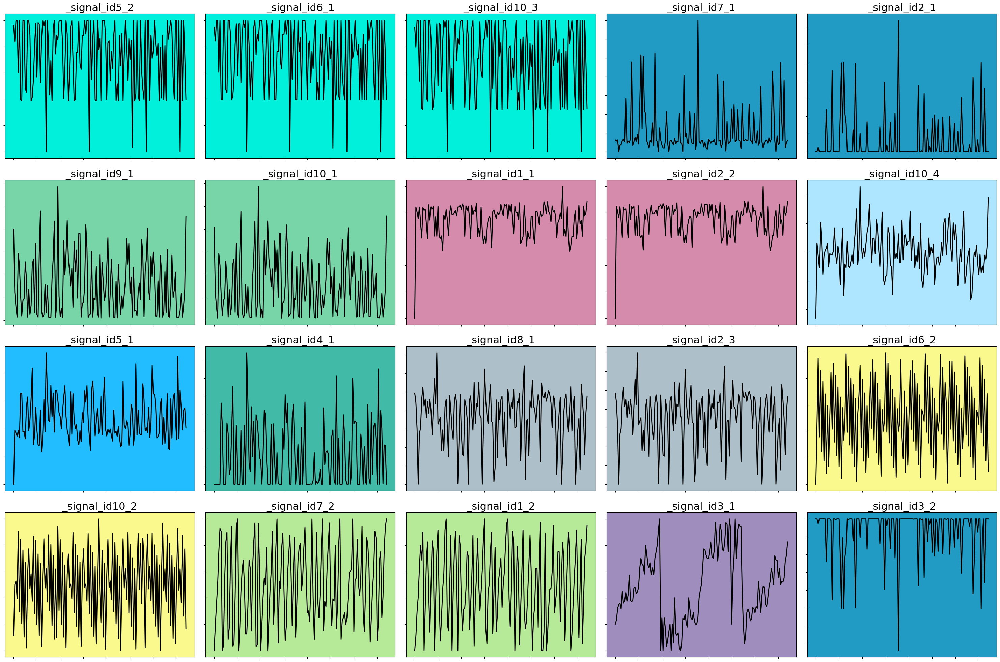

############################ Correlation type:  kendall
----------------------------- DBSCAN clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster -1: id7_1, id10_4, id7_2, id1_2, id3_1
Cluster 1: id2_1, id3_2
Cluster 2: id9_1, id10_1
Cluster 3: id1_1, id2_2
Cluster 4: id5_1, id4_1
Cluster 5: id8_1, id2_3
Cluster 6: id6_2, id10_2


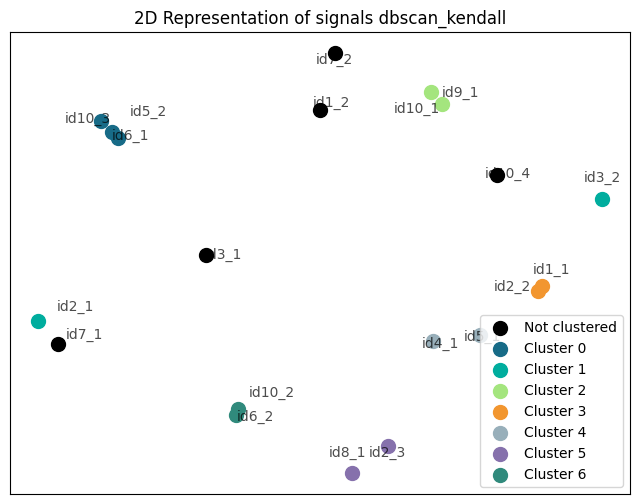

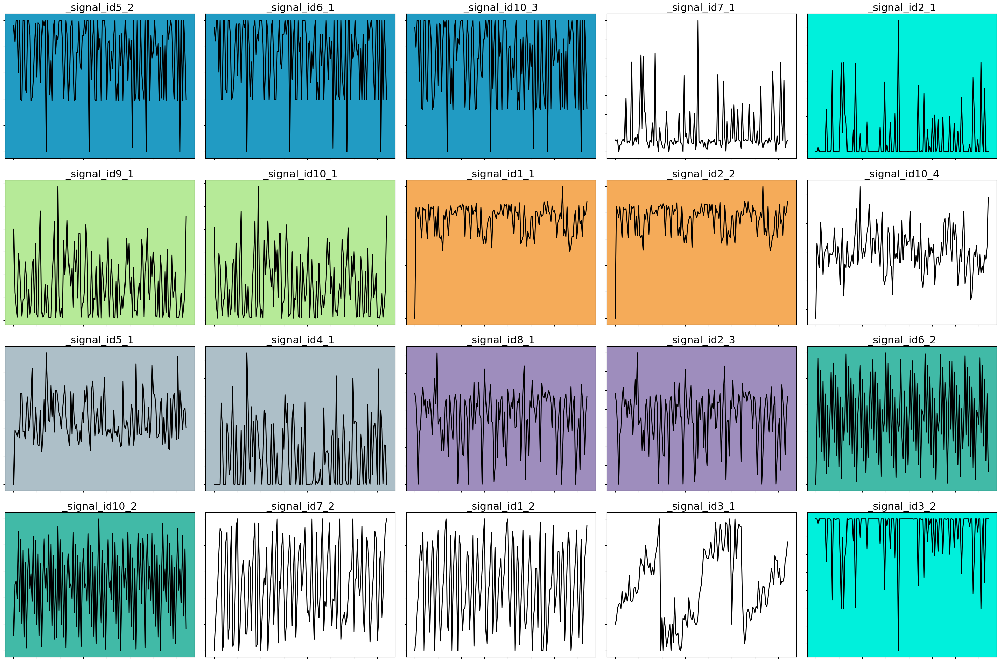

----------------------------- Affinity propagation clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster 7: id7_1, id2_1, id3_2
Cluster 1: id9_1, id10_1, id10_4, id3_1
Cluster 2: id1_1, id2_2
Cluster 3: id5_1, id4_1
Cluster 4: id8_1, id2_3
Cluster 5: id6_2, id10_2
Cluster 6: id7_2, id1_2


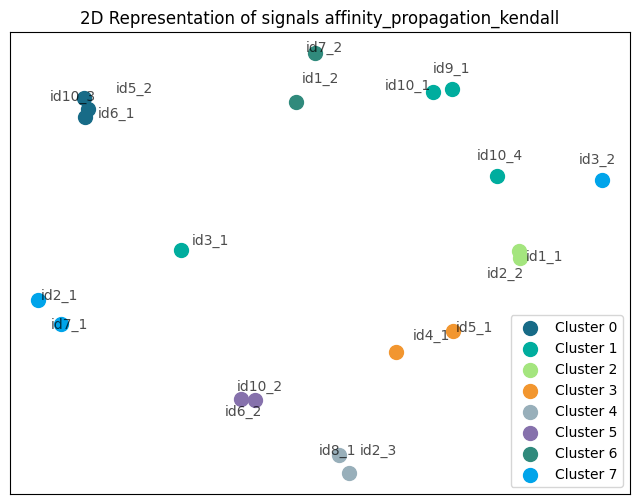

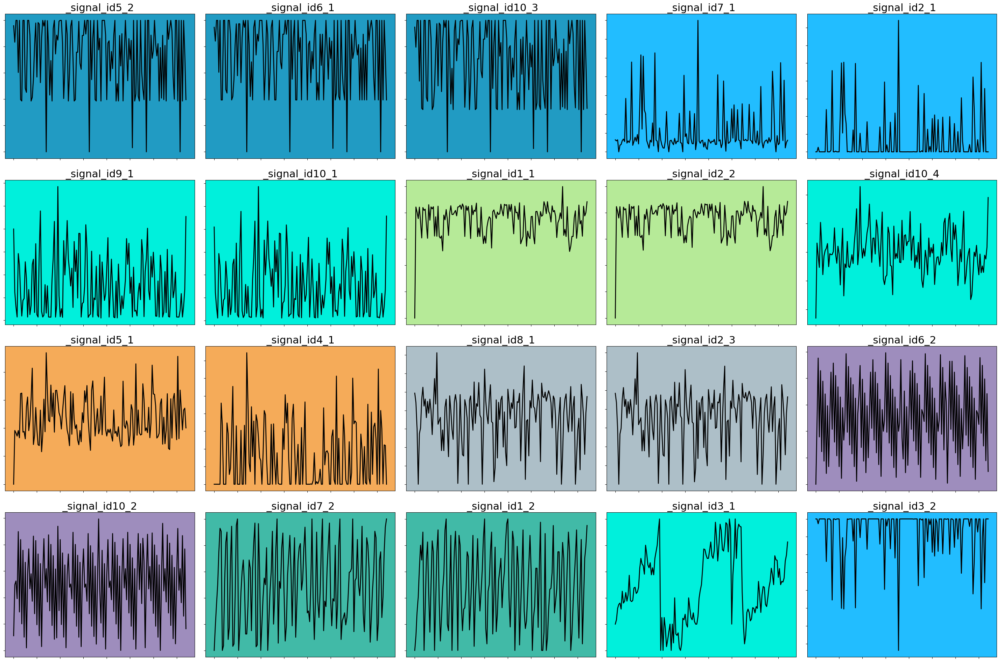

----------------------------- Hierarchical clustering with pairwise distances --------------------------
Cluster 13: id5_2, id6_1, id10_3
Cluster 2: id7_1
Cluster 1: id2_1, id3_2
Cluster 7: id9_1, id10_1
Cluster 0: id1_1, id2_2
Cluster 8: id10_4
Cluster 5: id5_1
Cluster 6: id4_1
Cluster 12: id8_1, id2_3
Cluster 3: id6_2
Cluster 4: id10_2
Cluster 10: id7_2
Cluster 11: id1_2
Cluster 9: id3_1


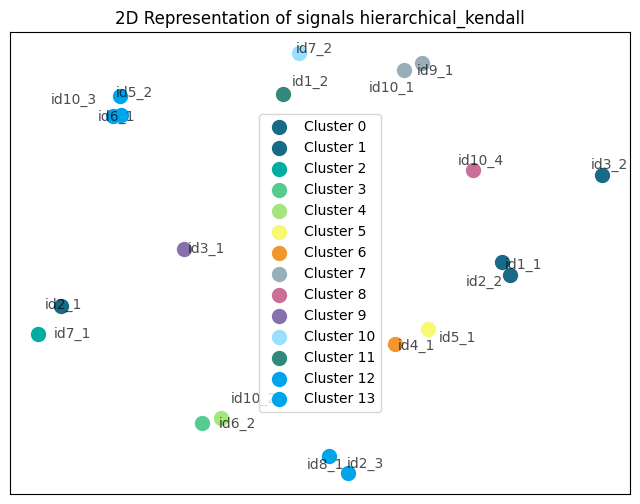

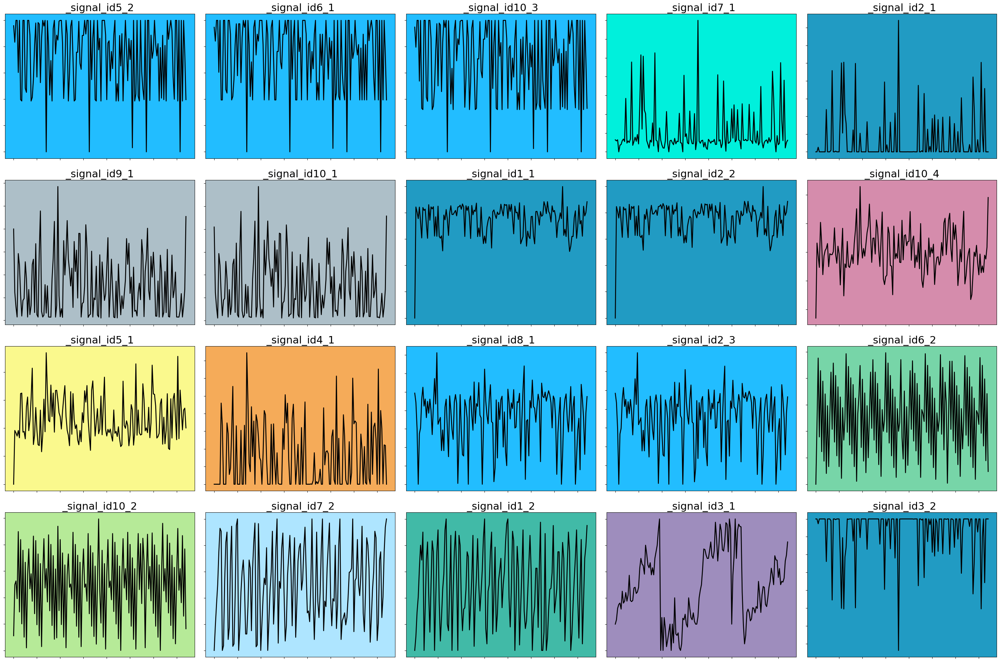

----------------------------- MeanShift clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster 7: id7_1
Cluster 3: id2_1, id3_2
Cluster 1: id9_1, id10_1
Cluster 4: id1_1, id2_2
Cluster 10: id10_4
Cluster 12: id5_1
Cluster 11: id4_1
Cluster 5: id8_1, id2_3
Cluster 2: id6_2, id10_2
Cluster 9: id7_2
Cluster 8: id1_2
Cluster 6: id3_1


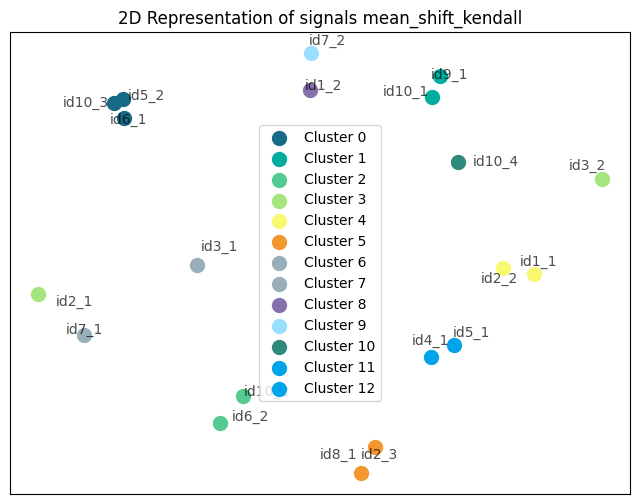

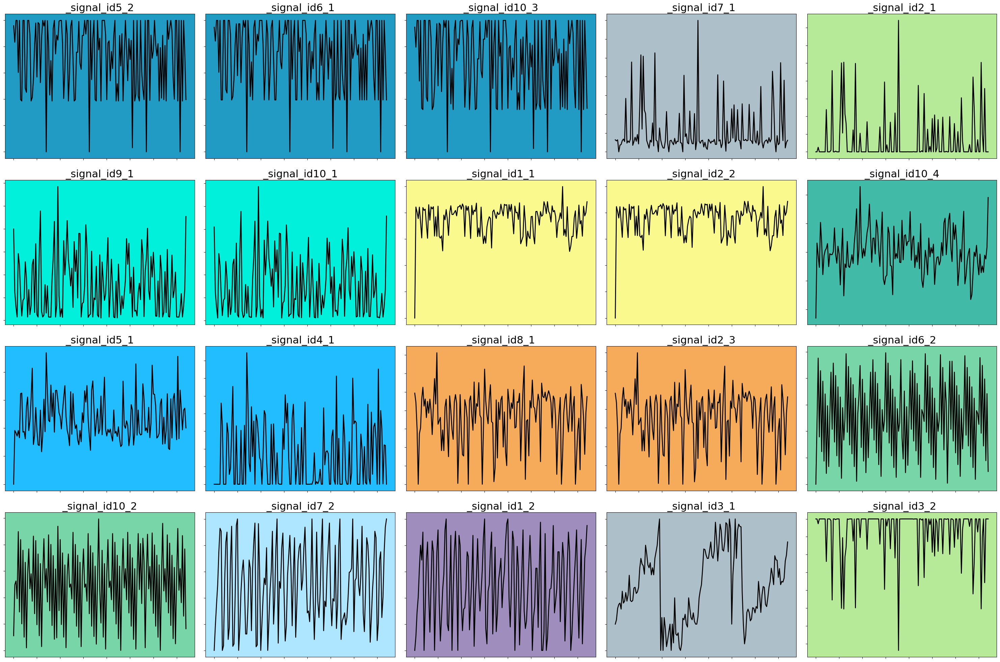

############################ Correlation type:  spearman
----------------------------- DBSCAN clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster 1: id7_1, id2_1, id3_2
Cluster 2: id9_1, id10_1, id10_4
Cluster 3: id1_1, id2_2
Cluster 4: id5_1, id4_1
Cluster 5: id8_1, id2_3
Cluster 6: id6_2, id10_2
Cluster -1: id7_2, id1_2, id3_1


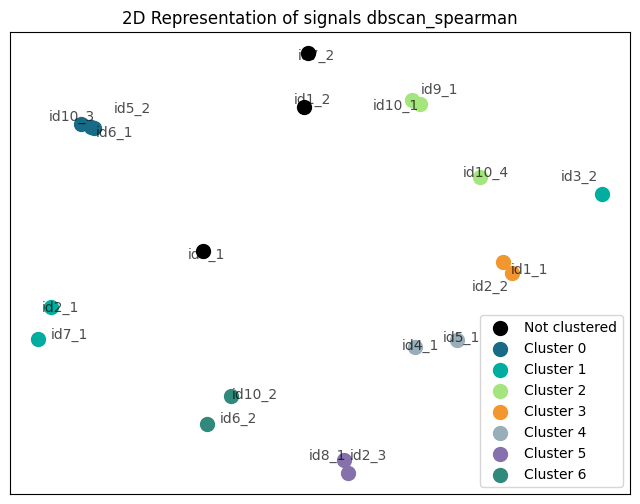

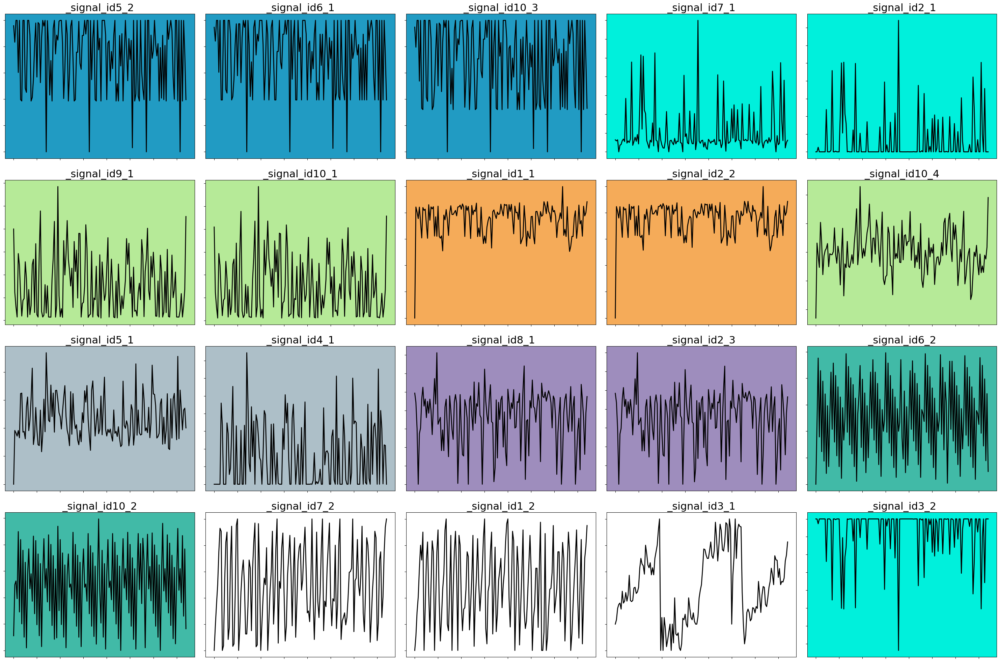

----------------------------- Affinity propagation clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster 7: id7_1, id2_1, id3_2
Cluster 1: id9_1, id10_1, id10_4, id3_1
Cluster 2: id1_1, id2_2
Cluster 3: id5_1, id4_1
Cluster 4: id8_1, id2_3
Cluster 5: id6_2, id10_2
Cluster 6: id7_2, id1_2


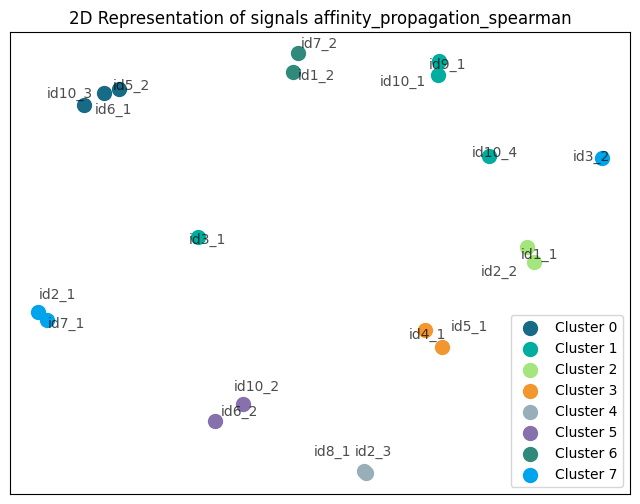

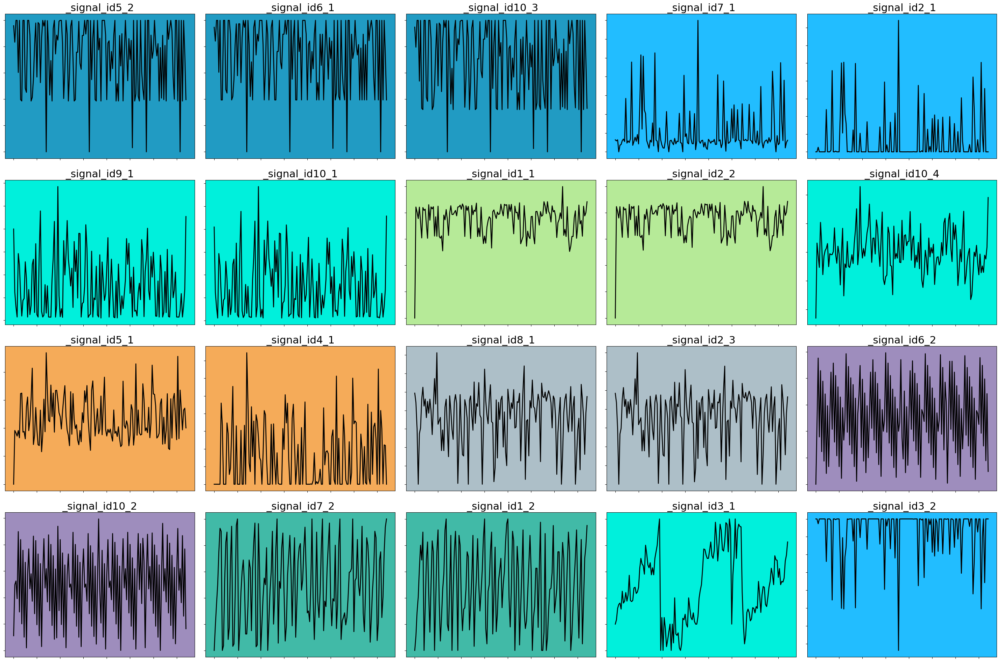

----------------------------- Hierarchical clustering with pairwise distances --------------------------
Cluster 6: id5_2, id6_1, id10_3
Cluster 9: id7_1
Cluster 8: id2_1, id3_2
Cluster 0: id9_1, id10_1
Cluster 7: id1_1, id2_2
Cluster 1: id10_4
Cluster 10: id5_1, id4_1
Cluster 5: id8_1, id2_3
Cluster 11: id6_2, id10_2
Cluster 3: id7_2
Cluster 4: id1_2
Cluster 2: id3_1


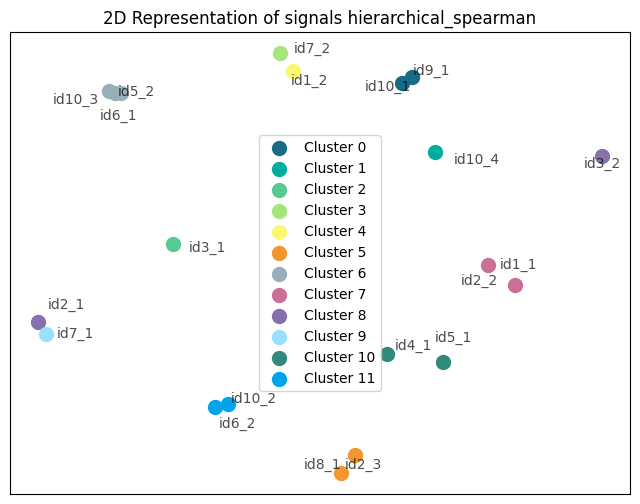

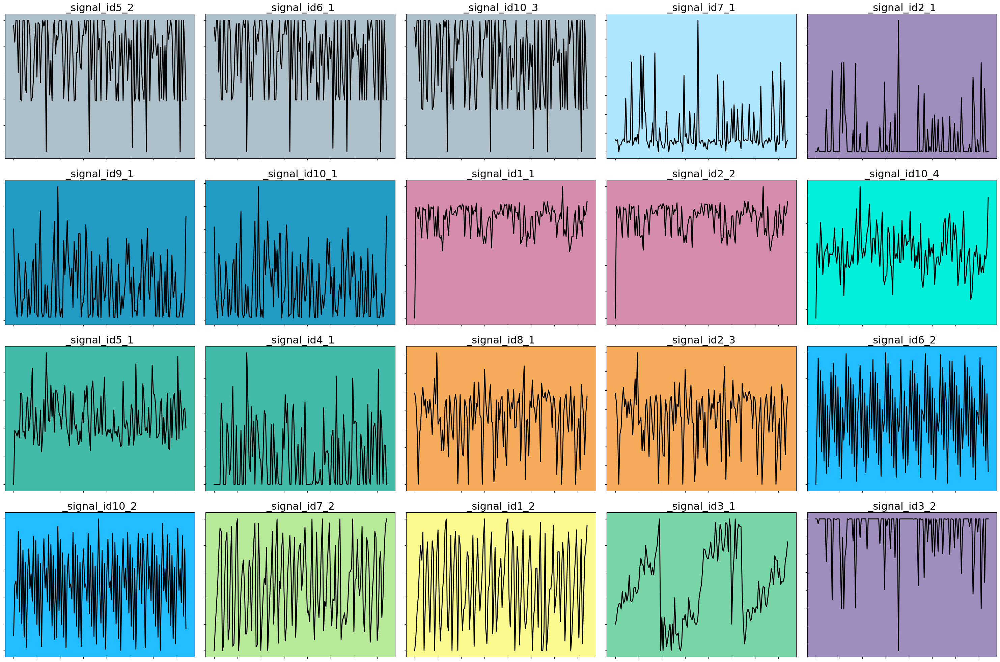

----------------------------- MeanShift clustering -----------------------------
Cluster 0: id5_2, id6_1, id10_3
Cluster 8: id7_1
Cluster 4: id2_1, id3_2
Cluster 1: id9_1, id10_1
Cluster 6: id1_1, id2_2
Cluster 9: id10_4
Cluster 11: id5_1
Cluster 10: id4_1
Cluster 5: id8_1, id2_3
Cluster 2: id6_2, id10_2
Cluster 3: id7_2, id1_2
Cluster 7: id3_1


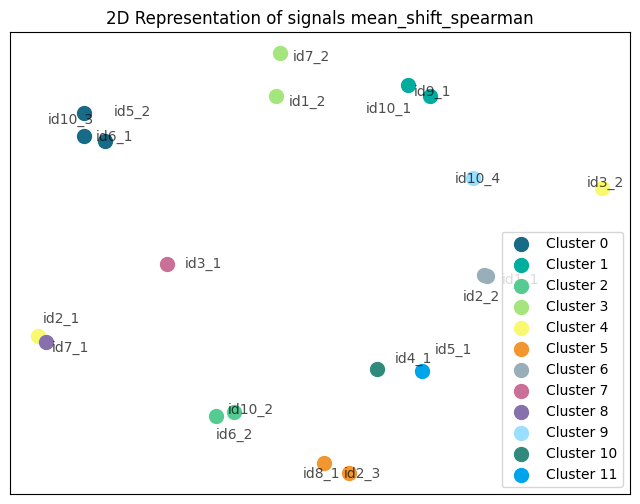

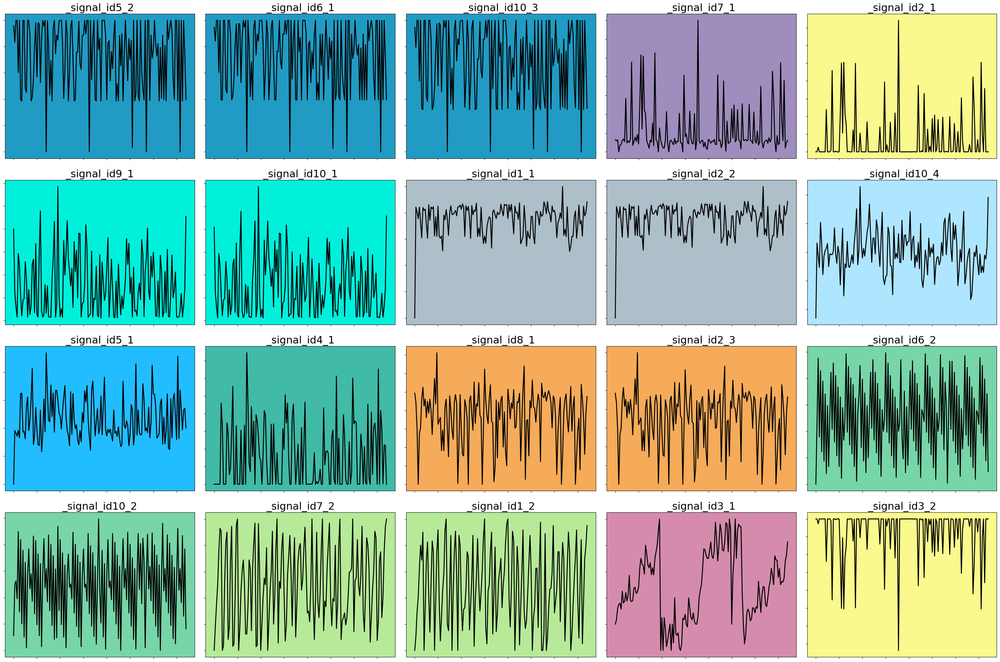

In [4]:
from scripts.correlation import analyze_correlation
correlation_types = ['pearson', 'kendall', 'spearman']

analyze_correlation(file = file, correlation_types = correlation_types)

# Hierarchical clustering

In [8]:
from scripts.data_preprocess import load_data
from scripts.config import Config
config = Config("conf3")
# Read train data from log file, extract signals and scale
data, _, _ = load_data(file, config)

Cluster 3: id5_2, id6_1, id10_3
Cluster 8: id7_1, id2_1, id3_2
Cluster 6: id9_1, id10_1
Cluster 4: id1_1, id2_2
Cluster 5: id10_4
Cluster 9: id5_1, id4_1
Cluster 7: id8_1, id2_3
Cluster 0: id6_2, id10_2
Cluster 1: id7_2
Cluster 2: id1_2
Cluster 10: id3_1


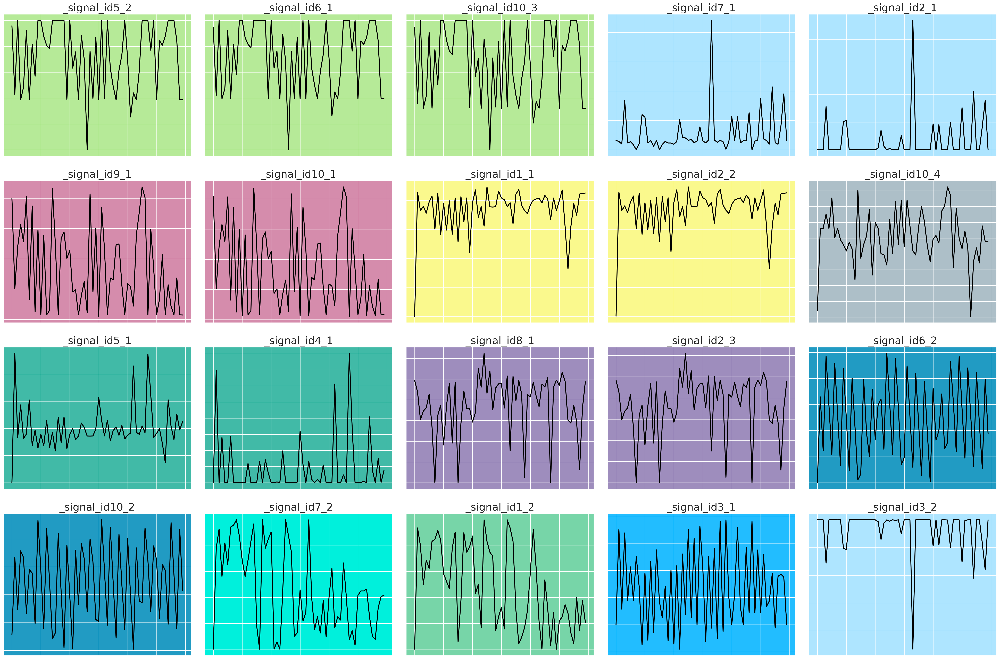

In [32]:
from scripts.correlation import visualize_signals_grouped, print_clusters
from scipy.spatial.distance import squareform
import scipy.cluster.hierarchy as spc
#downsample data for faster visualization
downsampled_data = data.iloc[::500000, :]

correlation_type = 'pearson'
corr_data = data.corr(method=correlation_type)
distance_matrix = 1 - abs(corr_data)
distance_matrix_1D = squareform(distance_matrix)
linkage = spc.linkage(distance_matrix_1D, method='complete')
cluster_labels=spc.fcluster(linkage, 0.2*distance_matrix_1D.max(), 'distance')
cluster_labels = [x-1 for x in cluster_labels] # To start from 0

print_clusters(data,cluster_labels)

# plot 2d representation of grouping
# plot signals grouped 
visualize_signals_grouped(original=downsampled_data, correlation_groups=cluster_labels, title="")

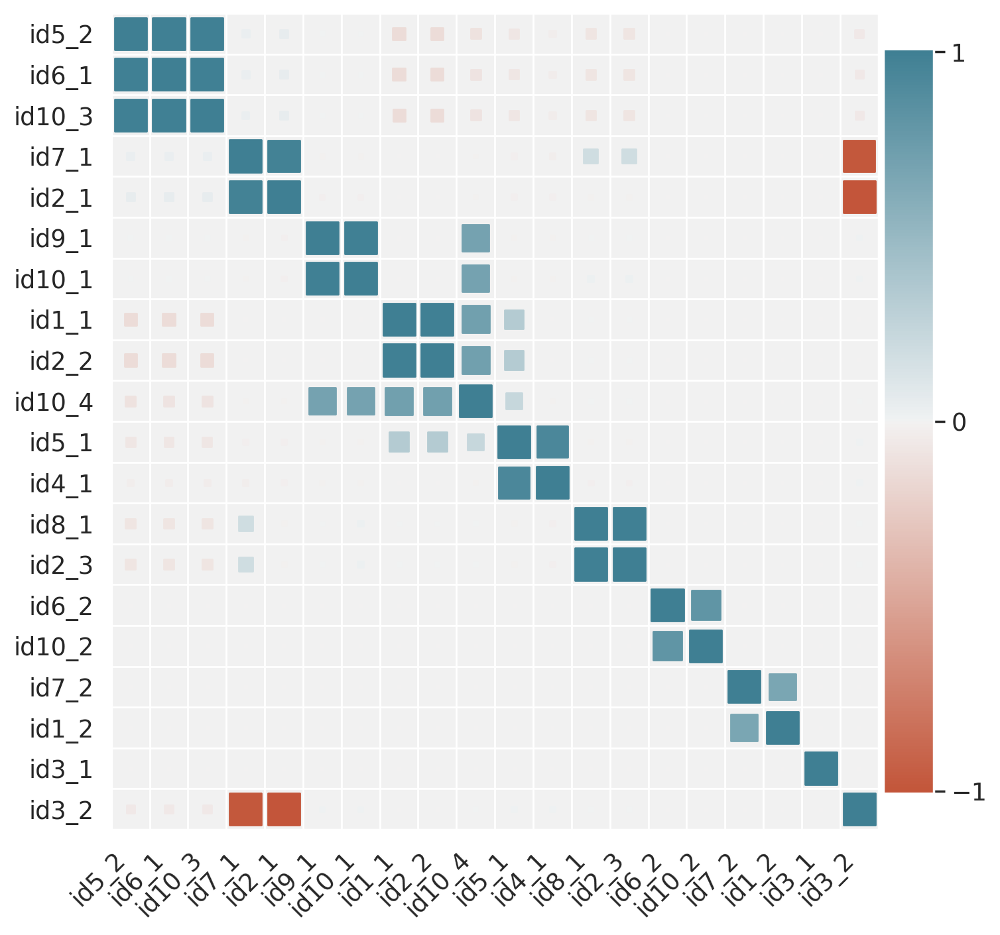

In [24]:
import pandas as pd
from matplotlib import pyplot as plt
from pylab import rcParams
rcParams['figure.figsize'] = 7,7 
import seaborn as sns
import numpy as np
sns.set(color_codes=True, font_scale=1.2)

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%load_ext autoreload
%autoreload 2

# Import the two methods from heatmap library
from heatmap import heatmap, corrplot

plt.figure(figsize=(8, 8))
corrplot(data.corr(), size_scale=300)

# Testing train input file

In [40]:
import pandas as pd
from scripts.config import input_data, work_dir

filename = f"{input_data}/SynCAN-master/train_input/SynCAN_interpolated_train_traces.csv"

# Read part of test file from csv - if stored in csv, all preprocess done
df_test = pd.read_csv(filename, skiprows=1, nrows=10, sep=',', dtype=float, header=None)
df_test




,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0.0,0.958686,0.246839,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
1,0.0,0.958686,0.246839,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
2,0.0,0.958686,0.246881,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
3,0.0,0.958686,0.246924,0.225,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
4,0.0,0.958686,0.246967,0.250,1.0,0.063899,0.03125,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
5,0.0,0.958686,0.247009,0.275,1.0,0.063910,0.06250,0.449719,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
6,0.0,0.958686,0.247052,0.300,1.0,0.063921,0.09375,0.449926,0.0,0.035714,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
7,0.0,0.958686,0.247095,0.325,1.0,0.063932,0.12500,0.450133,0.0,0.071429,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
8,0.0,0.958686,0.247137,0.350,1.0,0.063943,0.15625,0.450341,0.0,0.107143,0.0,0.0,0.241930,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
9,0.0,0.958686,0.247180,0.375,1.0,0.063954,0.18750,0.450548,0.0,0.142857,0.0,0.0,0.241975,0.947368,0.007407,0.454548,0.111111,0.947794,0.170395,0.0


In [41]:

# set column names according to first row in file
with open(filename, 'r') as f:
    column_names = f.readline().strip().split(',')
    df_test.columns = column_names
df_test

,id5_1,id5_2,id8_1,id3_1,id3_2,id7_1,id7_2,id9_1,id1_1,id1_2,id2_1,id2_2,id2_3,id6_1,id6_2,id10_1,id10_2,id10_3,id10_4,id4_1
0,0.0,0.958686,0.246839,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
1,0.0,0.958686,0.246839,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
2,0.0,0.958686,0.246881,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
3,0.0,0.958686,0.246924,0.225,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
4,0.0,0.958686,0.246967,0.250,1.0,0.063899,0.03125,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
5,0.0,0.958686,0.247009,0.275,1.0,0.063910,0.06250,0.449719,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
6,0.0,0.958686,0.247052,0.300,1.0,0.063921,0.09375,0.449926,0.0,0.035714,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
7,0.0,0.958686,0.247095,0.325,1.0,0.063932,0.12500,0.450133,0.0,0.071429,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
8,0.0,0.958686,0.247137,0.350,1.0,0.063943,0.15625,0.450341,0.0,0.107143,0.0,0.0,0.241930,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
9,0.0,0.958686,0.247180,0.375,1.0,0.063954,0.18750,0.450548,0.0,0.142857,0.0,0.0,0.241975,0.947368,0.007407,0.454548,0.111111,0.947794,0.170395,0.0


In [42]:
df_test.columns

Index(['id5_1', 'id5_2', 'id8_1', 'id3_1', 'id3_2', 'id7_1', 'id7_2', 'id9_1',
       'id1_1', 'id1_2', 'id2_1', 'id2_2', 'id2_3', 'id6_1', 'id6_2', 'id10_1',
       'id10_2', 'id10_3', 'id10_4', 'id4_1'],
      dtype='object')

In [11]:
from scripts.config import Config
config = Config('conf3')
ID_groups = config.signal_groups

In [27]:
df_test

,0.0,0.9586862512831164,0.24683876529406,0.2,1.0,0.0638881894828267,0.0.1,0.4495114006514658,0.0.2,0.0.3,0.0.4,0.0.5,0.2418848605644081,0.9473684210526316,0.0.6,0.4545479016065274,0.1111111111111111,0.9477939303961084,0.1703945623987118,0.0.7
0,0.0,0.958686,0.246839,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
1,0.0,0.958686,0.246881,0.200,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
2,0.0,0.958686,0.246924,0.225,1.0,0.063888,0.00000,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
3,0.0,0.958686,0.246967,0.250,1.0,0.063899,0.03125,0.449511,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
4,0.0,0.958686,0.247009,0.275,1.0,0.063910,0.06250,0.449719,0.0,0.000000,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
5,0.0,0.958686,0.247052,0.300,1.0,0.063921,0.09375,0.449926,0.0,0.035714,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
6,0.0,0.958686,0.247095,0.325,1.0,0.063932,0.12500,0.450133,0.0,0.071429,0.0,0.0,0.241885,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
7,0.0,0.958686,0.247137,0.350,1.0,0.063943,0.15625,0.450341,0.0,0.107143,0.0,0.0,0.241930,0.947368,0.000000,0.454548,0.111111,0.947794,0.170395,0.0
8,0.0,0.958686,0.247180,0.375,1.0,0.063954,0.18750,0.450548,0.0,0.142857,0.0,0.0,0.241975,0.947368,0.007407,0.454548,0.111111,0.947794,0.170395,0.0
9,0.0,0.958686,0.247237,0.400,1.0,0.063966,0.21875,0.450755,0.0,0.178571,0.0,0.0,0.242019,0.947368,0.014815,0.454548,0.111111,0.947794,0.170395,0.0


In [14]:
ID_groups

[['id5_2', 'id6_1', 'id10_3'],
 ['id7_1', 'id2_1'],
 ['id9_1', 'id10_1'],
 ['id1_1', 'id2_2'],
 ['id10_4'],
 ['id5_1', 'id4_1'],
 ['id8_1', 'id2_3'],
 ['id6_2', 'id10_2'],
 ['id7_2', 'id1_2'],
 ['id3_1'],
 ['id3_2']]

In [21]:
rearranged_columns = []
cols = 0
# signal ID-s in config are always in an array, if we only got 1 signal, for loop would return characters in its ID, so we treat it differently
if len(ID_groups) != 1:
        
        # iterate each group
        for group in ID_groups:
                # iterate each signal in group
                for index in group:
                        rearranged_columns.append(index)

        # make new df with the rearranged columns
        df_test_rearranged = df_test[rearranged_columns]
        
        # cols will tell how many signals to visualize in a row when calling visualize_signals, not actual column number
        cols = 3